<a href="https://colab.research.google.com/github/chichvarin/skf_projects/blob/main/Poverty_rate_analysis_Clustering_ver2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [397]:
# 1 этап загрузка данных из всех источников

In [398]:
import pandas as pd
import seaborn as sns
from sklearn.neighbors import NearestNeighbors
from random import sample
from numpy.random import uniform
import numpy as np
from math import isnan
 

In [399]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None) 

In [400]:
# подключаем google диск, где у нас хранятся данные
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [401]:
 pip install xlrd==1.2.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [402]:
def fix_regions(x):
    if pd.isnull(x):
        return x
    if x == 'nan':
        return None

    x = x.replace('автономный округ', 'АО')
    x = x.replace('автономная область', 'АО')
    x = x.replace('авт. область', 'АО')
    x = x.replace('обл.', 'область')

    if 'округ' in x and 'автономный' not in x:
        return None
    if 'Таймырский' in x:
        return None
    if 'федеральный округ' in x:
        return None
    if 'Федерация' in x:
        return None
    if 'район' in x:
        return None
    if 'Эвенкийский' in x:
        return None
    if 'Чеченская и Ингушская Республики' in x:
        return None    
    if 'Москва' in x:
        return 'Москва'
    if 'Санкт-Петербург' in x:
        return 'Санкт-Петербург'
    if 'Севастополь' in x:
        return 'Севастополь'
    if 'в том числе' in x:
        return None
    if 'Кемеровская' in x:
        return 'Кемеровская область - Кузбасс'
    if 'Чувашская' in x:
        return 'Чувашская Республика - Чувашия'
    if 'Ханты-Мансийский' in x:
        return 'Ханты-Мансийский АО - Югра'
    if 'Байконур' in x:
        return None
    if 'сельсовет' in x:
        return None
    if 'рп' in x:
        return None
    if 'пункты' in x:
        return None
    if 'поссовет' in x:
        return None
    if 'МВД' in x:
        return None
    if 'Транспорт' in x:
        return None
    if 'Ямало-Ненецкий' in x:
        return 'Ямало-Ненецкий АО'
    if 'Ярославская' in x:
        return 'Ярославская область'
        
    if '(' in x:
        x = x[:x.find('(')] 
        
    return x

In [403]:
def fix_regions_for_hom(x):
  
    x = x.replace('авт. область', 'АО')
    x = x.replace('авт. округ', 'АО')

    if 'Москва' in x:
        return 'Москва'
    if 'Санкт-Петербург' in x:
        return 'Санкт-Петербург'
    if 'Севастополь' in x:
        return 'Севастополь'
    if 'Кемеровская' in x:
        return 'Кемеровская область - Кузбасс'
    if 'Чувашская' in x:
        return 'Чувашская Республика - Чувашия'
    if 'Ханты-Мансийский' in x:
        return 'Ханты-Мансийский АО - Югра'
    if 'Архангельская' in x:
        return 'Архангельская область'
    if 'Тюменская' in x:
        return 'Тюменская область'  
    if 'Чувашская' in x:
        return 'Чувашская Республика - Чувашия'
    if 'Якутия' in x:
        return 'Республика Саха'  
                      
    return x

In [404]:
def fix_regions_id(x):
    if pd.isnull(x):
        return x
    if x == 'nan':
        return None

    x = x.replace('автономный округ', 'АО')
    x = x.replace('автономная область', 'АО')
    x = x.replace('авт. область', 'АО')
    x = x.replace('Автономна Республіка Крим', 'Республика Крым')
    x = x.replace('Башкортостан', 'Республика Башкортостан')
    x = x.replace('Бурятия', 'Республика Бурятия')  
    x = x.replace('Дагестан', 'Республика Дагестан')
    x = x.replace('Ингушетия', 'Республика Ингушетия')
    x = x.replace('Кабардино-Балкария', 'Кабардино-Балкарская Республика')
    x = x.replace('Карачаево-Черкесия', 'Карачаево-Черкесская Республика')
    x = x.replace('Марий Эл', 'Республика Марий Эл')
    x = x.replace('Мордовия', 'Республика Мордовия')
    x = x.replace('Северная Осетия - Алания', 'Республика Северная Осетия-Алания')
    x = x.replace('Татарстан', 'Республика Татарстан')
    x = x.replace('Тыва', 'Республика Тыва')
    x = x.replace('Калмыкия', 'Республика Калмыкия')
    x = x.replace('Чеченская республика', 'Чеченская Республика')
    x = x.replace('Чувашия', 'Чувашская Республика - Чувашия')
    x = x.replace('Удмуртия', 'Удмуртская Республика')
    x = x.replace('Адыгея', 'Республика Адыгея')

    if 'округ' in x and 'автономный' not in x:
        return None
    if 'Таймырский' in x:
        return None
    if 'федеральный округ' in x:
        return None
    if 'Федерация' in x:
        return None
    if 'район' in x:
        return None
    if 'Эвенкийский' in x:
        return None
    if 'Чеченская и Ингушская Республики' in x:
        return None    
    if 'Москва' in x:
        return 'Москва'
    if 'Санкт-Петербург' in x:
        return 'Санкт-Петербург'
    if 'Севастополь' in x:
        return 'Севастополь'
    if 'в том числе' in x:
        return None
    if 'Кемеровская' in x:
        return 'Кемеровская область - Кузбасс'
    if 'Чувашская' in x:
        return 'Чувашская Республика - Чувашия'
    if 'Ханты-Мансийский' in x:
        return 'Ханты-Мансийский АО - Югра'
    if 'Байконур' in x:
        return None
    if 'сельсовет' in x:
        return None
    if 'рп' in x:
        return None
    if 'пункты' in x:
        return None
    if 'поссовет' in x:
        return None
    if 'МВД' in x:
        return None
    if 'Транспорт' in x:
        return None
    if 'Ямало-Ненецкий' in x:
        return 'Ямало-Ненецкий АО'
    if 'Ярославская' in x:
        return 'Ярославская область'
        
    if '(' in x:
        x = x[:x.find('(')] 
        
    return x

In [405]:
# население -  
pop_df = pd.read_excel('/content/drive/My Drive/Heart Core Team/population_new.xlsx', header=1)

# удалим лишние колонки Оба пола и Селское население - везде
pop_df.drop(['Unnamed: 1'], axis = 1, inplace=True)
# переименуем для удобства колонку с названиями регионов
pop_df.rename(columns={'Unnamed: 0':"Region"}, inplace=True)
# применим условие для очистки названий регионов
pop_df.Region = pop_df.Region.apply(fix_regions)
pop_df = pop_df.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
pop_df.Region = pop_df['Region'].str.strip()
# назначим название области индексом
pop_df.set_index('Region', inplace=True)
#оставим только указание года в header
#pop_df.columns = pop_df.columns.str.replace('[^a-zA-Z0-9]', '', regex=True).str.strip()

print("Уникальных значений:", pop_df.index.nunique())

Уникальных значений: 85


In [406]:
# Детская смертность 1
cmr_df = pd.read_excel('/content/drive/My Drive/Heart Core Team/child_mortality_urban_1990_2021.xls', skiprows=2)

# удалим лишние колонки Оба пола и Селское население - везде
cmr_df.drop(['Unnamed: 1', 'Unnamed: 2'], axis = 1, inplace=True)
cmr_df.rename(columns={'Unnamed: 0':"Region"}, inplace=True)
# применим условие для очистки названий регионов
cmr_df.Region = cmr_df.Region.apply(fix_regions)
# удалим лишние пробелы в названиях
cmr_df.Region = cmr_df['Region'].str.strip()
# убираем нерелевантные регионы
cmr_df = cmr_df.dropna(subset = ['Region'])
# назначим название области индексом
cmr_df.set_index('Region', inplace=True)

print("Уникальных значений:", cmr_df.index.nunique())

Уникальных значений: 85


In [407]:
# Детская смертность 2
# добавим параметры
cmu_df = pd.read_excel('/content/drive/My Drive/Heart Core Team/child_mortality_urban_1990_2021.xls', skiprows=2)

# удалим лишние колонки Оба пола и Селское население - везде
cmu_df.drop(['Unnamed: 1', 'Unnamed: 2'], axis = 1, inplace=True)
# переименуем для удобства колонку с названиями регионов
cmu_df.rename(columns={'Unnamed: 0':"Region"}, inplace=True)
# применим условие для очистки названий регионов
cmu_df.Region = cmu_df.Region.apply(fix_regions)
cmu_df = cmu_df.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
cmu_df.Region = cmu_df['Region'].str.strip()
# назначим название области индексом
cmu_df.set_index('Region', inplace=True)

print("Уникальных значений:", cmu_df.index.nunique())

Уникальных значений: 85


In [408]:
# детская смертность до 1 года на 1000 родившихся
infm_df = pd.read_excel('/content/drive/My Drive/Heart Core Team/infant_mortality.xlsx')

# переименуем для удобства колонку с названиями регионов
infm_df.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
infm_df.Region = infm_df.Region.apply(fix_regions)
infm_df = infm_df.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
infm_df.Region = infm_df['Region'].str.strip()
# назначим название области индексом
infm_df.set_index('Region', inplace=True)

print("Уникальных значений:", infm_df.index.nunique())

Уникальных значений: 85


In [409]:
set(cmr_df.index).difference(set(infm_df.index))

set()

In [410]:
# смертность от отравления алкоголя (есть пропущенные значения в виде нулей)
alco_df = pd.read_excel('/content/drive/My Drive/Heart Core Team/alco_mortality.xlsx')

# переименуем для удобства колонку с названиями регионов
alco_df.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
alco_df.Region = alco_df.Region.apply(fix_regions)
alco_df = alco_df.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
alco_df.Region = alco_df['Region'].str.strip()
# назначим название области индексом
alco_df.set_index('Region', inplace=True)

print("Уникальных значений:", alco_df.index.nunique())

Уникальных значений: 85


In [411]:
df1 = alco_df.loc[:,'2016':'2018']
df2 = pop_df.loc[:,2016:2018]
v = (df1.values / df2.values)*100
alcmort = pd.DataFrame(v, index=df1.index)
alcmort.columns = [2016, 2017, 2018]

In [412]:
# валовый региональный продукт на душу населения
grp_df = pd.read_excel('/content/drive/My Drive/Heart Core Team/gross_regional_product_1996_2020.xls', skiprows=2)

# переименуем для удобства колонку с названиями регионов
grp_df.rename(columns={'Unnamed: 0':"Region"}, inplace=True)
# применим условие для очистки названий регионов
grp_df.Region = grp_df.Region.apply(fix_regions)
grp_df = grp_df.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
grp_df.Region = grp_df['Region'].str.strip()
# назначим название области индексом
grp_df.set_index('Region', inplace=True)

print("Уникальных значений:", grp_df.index.nunique())

Уникальных значений: 85


In [413]:
set(cmr_df.index).difference(set(grp_df.index))

set()

In [414]:
# денежные доходы населения
cri_df = pd.read_excel('/content/drive/My Drive/Heart Core Team/cash_real_income_wages_2015_2020.xlsx')

# переименуем для удобства колонку с названиями регионов
cri_df.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
cri_df.Region = cri_df.Region.apply(fix_regions)
# удалим /n в названиях регионов
cri_df['Region'].replace(r'\s+|\\n', ' ', regex=True, inplace=True) 
cri_df = cri_df.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
cri_df.Region = cri_df['Region'].str.strip()
# назначим название области индексом
cri_df.set_index('Region', inplace=True)

print("Уникальных значений:", cri_df.index.nunique())

Уникальных значений: 85


In [415]:
set(cri_df.index).difference(set(grp_df.index))

set()

In [416]:
# инвалидность - взять столбец всего и сгруппировать по годам
dab_df = pd.read_csv('/content/drive/My Drive/Heart Core Team/disabled_total_by_age_2017_2022.csv')

# переименуем для удобства колонку с названиями регионов
dab_df.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
dab_df.Region = dab_df.Region.apply(fix_regions)
# удалим /n в названиях регионов
dab_df['Region'].replace(r'\s+|\\n', ' ', regex=True, inplace=True) 
dab_df = dab_df.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
dab_df.Region = dab_df['Region'].str.strip()
# назначим название области индексом
# dab_df.set_index('Region', inplace=True)

print("Уникальных значений:", dab_df.Region.nunique())

Уникальных значений: 85


In [417]:
dab_df['date'] = pd.to_datetime(dab_df['date'])
dab_df['year'] = dab_df['date'].dt.year

In [418]:
pivot_dab = dab_df.pivot_table(values=['total'],
index=['Region'],
columns=['year'],
aggfunc='sum',
margins=True,
fill_value=0)

In [419]:
pivot_dab.drop(pivot_dab.tail(1).index,inplace=True) # drop last row 'All'
pivot_dab.columns = [ 2016, 2017, 2018, 2019, 2020, 2021, 'All']

In [420]:
set(pop_df.index).difference(set(pivot_dab.index))

set()

In [421]:
df3 = pivot_dab.loc[:,2016:2018]
df4 = pop_df.loc[:,2016:2018]
v = (df3.values / df4.values)*100
dab_r = pd.DataFrame(v, index=df3.index)
dab_r.columns = [2016, 2017, 2018]

In [422]:
#домохозяйства - показатель размер жилой площади и жилая площадь на члена домохозяйства
hom_df = pd.read_excel('/content/drive/My Drive/Heart Core Team/housing_2020.xlsx') 

# выявим строки содержащие федеральный округ, федерация и район
fo = hom_df[hom_df['Регион'].str.contains('федеральный округ|Федерация|район|числе')].index
hom_df.drop(fo, axis = 0, inplace=True)
hom_df.rename(columns={'Регион':"Region"}, inplace=True)
# применим условие для очистки названий регионов
hom_df.Region = hom_df.Region.apply(fix_regions_for_hom)
hom_df["Region"] = hom_df["Region"].str.strip()
hom_df.set_index('Region', inplace=True)

print(hom_df.shape)

(85, 8)


In [423]:
set(cri_df.index).difference(set(hom_df.index))

set()

In [424]:
housing = hom_df.iloc[:, [3, 6]]
housing.columns = ['Дом-ва с большой жилищной стесненностью, %', 'Жилая площадь на члена домохозяйства, м2/чел.']

In [428]:
# малоимущее население по регионам всего
ppop_df = pd.read_csv('/content/drive/My Drive/Heart Core Team/poverty_percent_by_regions_1992_2020.csv')

# переименуем для удобства колонку с названиями регионов
ppop_df.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
ppop_df.Region = ppop_df.Region.apply(fix_regions)
ppop_df = ppop_df.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
ppop_df.Region = ppop_df['Region'].str.strip()
# назначим название области индексом
ppop_df.set_index('Region', inplace=True)

print("Уникальных значений:", ppop_df.index.nunique())

Уникальных значений: 85


In [429]:
ppop_df = ppop_df.loc[(ppop_df['year'] >= 2016) & (ppop_df['year'] <= 2018)]
ppop_mean = ppop_df.groupby(['Region'])[['poverty_percent']].mean().sort_values(['poverty_percent'],ascending=False)

In [430]:
set(ppop_mean.index).difference(set(grp_df.index))

set()

In [431]:
# малоимущее население по группам - даст три признака - малоимущие дети, старики и люди трудоспособного возраста (процент)
# добавить ещё 2018, 2019, соединить и средний показатель вычислить
gr_ppop17 = pd.read_excel('/content/drive/My Drive/Heart Core Team/poverty_socdem_2017.xls')

gr_ppop17.columns = ['Region', 'All population', 'Children under 16', 'Over working age population', 'Working age population']

# применим условие для очистки названий регионов
gr_ppop17.Region = gr_ppop17.Region.apply(fix_regions)
gr_ppop17 = gr_ppop17.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
gr_ppop17.Region = gr_ppop17['Region'].str.strip()
# назначим название области индексом
gr_ppop17.set_index('Region', inplace=True)

print("Уникальных значений:", gr_ppop17.index.nunique())

Уникальных значений: 85


In [432]:
gr_ppop18 = pd.read_excel('/content/drive/My Drive/Heart Core Team/poverty_socdem_2018.xls')

gr_ppop18.columns = ['Region', 'All population', 'Children under 16', 'Over working age population', 'Working age population']

# применим условие для очистки названий регионов
gr_ppop18.Region = gr_ppop18.Region.apply(fix_regions)
gr_ppop18 = gr_ppop18.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
gr_ppop18.Region = gr_ppop18['Region'].str.strip()
# назначим название области индексом
gr_ppop18.set_index('Region', inplace=True)

print("Уникальных значений:", gr_ppop18.index.nunique())

Уникальных значений: 85


In [433]:
gr_ppop19 = pd.read_excel('/content/drive/My Drive/Heart Core Team/poverty_socdem_2019.xls')

gr_ppop19.columns = ['Region', 'All population', 'Children under 16', 'Over working age population', 'Working age population']

# применим условие для очистки названий регионов
gr_ppop19.Region = gr_ppop19.Region.apply(fix_regions)
gr_ppop19 = gr_ppop19.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
gr_ppop19.Region = gr_ppop19['Region'].str.strip()
# назначим название области индексом
gr_ppop19.set_index('Region', inplace=True)

print("Уникальных значений:", gr_ppop19.index.nunique())

Уникальных значений: 85


In [434]:
childpov = pd.concat([gr_ppop17['Children under 16'], gr_ppop18['Children under 16'], gr_ppop19['Children under 16']], axis=1, keys=['2017', '2018','2019']).astype(float)

In [435]:
childpov=childpov.mask(childpov==0).apply(lambda row: row.fillna(row.mean()), axis=1)

In [436]:
overwpov = pd.concat([gr_ppop17['Over working age population'], gr_ppop18['Over working age population'], gr_ppop19['Over working age population']], axis=1, keys=['2017', '2018','2019']).astype(float)

In [437]:
overwpov=overwpov.mask(overwpov==0).apply(lambda row: row.fillna(row.mean()), axis=1)

In [438]:
workagepov = pd.concat([gr_ppop17['Working age population'], gr_ppop18['Working age population'], gr_ppop19['Working age population']], axis=1, keys=['2017', '2018','2019']).astype(float)

In [439]:
workagepov=workagepov.mask(workagepov==0).apply(lambda row: row.fillna(row.mean()), axis=1)

In [440]:
# regional production
reg_prod = pd.read_csv('/content/drive/My Drive/Heart Core Team/regional_production_2017_2020.csv')

print(reg_prod['production_field'].nunique()) # всего 133 различных категории - нужен творческий подход
reg_prod[140:160]

133


,region,production_field,2017,2018,2019,2020
140,Белгородская область,"ОБЕСПЕЧЕНИЕ ЭЛЕКТРИЧЕСКОЙ ЭНЕРГИЕЙ, ГАЗОМ И ПА...",2.703072e+07,2.680549e+07,2.654258e+07,2.678738e+07
141,Белгородская область,"ВОДОСНАБЖЕНИЕ; ВОДООТВЕДЕНИЕ, ОРГАНИЗАЦИЯ СБОР...",1.061410e+07,8.936415e+06,1.140417e+07,1.117503e+07
142,Белгородская область,Промышленное производство (промышленность),7.833257e+08,8.954341e+08,9.390364e+08,9.741469e+08
143,Брянская область,ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ,2.774277e+05,2.615495e+05,3.380273e+05,3.106659e+05
144,Брянская область,ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА,1.910189e+08,2.185441e+08,2.536616e+08,2.556862e+08
145,Брянская область,"ОБЕСПЕЧЕНИЕ ЭЛЕКТРИЧЕСКОЙ ЭНЕРГИЕЙ, ГАЗОМ И ПА...",1.606411e+07,1.773026e+07,1.770875e+07,1.787640e+07
146,Брянская область,"ВОДОСНАБЖЕНИЕ; ВОДООТВЕДЕНИЕ, ОРГАНИЗАЦИЯ СБОР...",7.347143e+06,8.901073e+06,9.258735e+06,9.588966e+06
147,Брянская область,Промышленное производство (промышленность),2.147076e+08,2.454370e+08,2.809671e+08,2.834622e+08
148,Владимирская область,ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ,4.003911e+06,5.005219e+06,5.425672e+06,4.965110e+06
149,Владимирская область,ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА,4.064836e+08,4.484277e+08,4.918302e+08,5.261537e+08


In [441]:
# переименуем для удобства колонку с названиями регионов
reg_prod.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
reg_prod.Region = reg_prod.Region.apply(fix_regions)
reg_prod = reg_prod.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
reg_prod.Region = reg_prod['Region'].str.strip()
# назначим название области индексом
reg_prod.set_index('Region', inplace=True)

print("Уникальных значений:", reg_prod.index.nunique())

Уникальных значений: 85


In [442]:
set(reg_prod.index).difference(set(cmr_df.index))

set()

In [443]:
# розничная торговля на душу населения рублей
retail = pd.read_excel('/content/drive/My Drive/Heart Core Team/retail_turnover_per_capita_2000_2021.xls', skiprows=2)

# удалим лишние колонки Оба пола и Селское население - везде
retail.drop(['Unnamed: 1'], axis = 1, inplace=True)
# переименуем для удобства колонку с названиями регионов
retail.rename(columns={'Unnamed: 0':"Region"}, inplace=True)
# применим условие для очистки названий регионов
retail.Region = retail.Region.apply(fix_regions)
retail = retail.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
retail.Region = retail['Region'].str.strip()
# назначим название области индексом
retail.set_index('Region', inplace=True)

print("Уникальных значений:", retail.index.nunique())

Уникальных значений: 85


In [444]:
set(retail.index).difference(set(cmr_df.index))

set()

In [445]:
wes_df = pd.read_excel('/content/drive/My Drive/Heart Core Team/welfare_expense_share_2015_2020.xlsx')

# переименуем для удобства колонку с названиями регионов
wes_df.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
wes_df['Region'] = wes_df['Region'].replace('\n',' ', regex=True)
wes_df.Region = wes_df.Region.apply(fix_regions)
wes_df = wes_df.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
wes_df.Region = wes_df['Region'].str.strip()
# назначим название области индексом
wes_df.set_index('Region', inplace=True)

print("Уникальных значений:", wes_df.index.nunique())

Уникальных значений: 85


In [446]:
set(wes_df.index).difference(set(cmr_df.index))

set()

In [447]:
wes_df.head()

,2015.0,2016.0,2017.0,2018.0,2019.0,2020.0
Region,,,,,,
Белгородская область,11.3,11.8,16.4,15.6,13.8,16.1
Брянская область,22.0,26.6,24.7,23.7,20.7,23.1
Владимирская область,18.1,18.0,24.0,23.4,23.4,26.0
Воронежская область,15.2,15.4,22.8,20.9,19.0,21.6
Ивановская область,18.1,28.9,28.7,27.0,25.1,25.1


EXTRA DATA

In [448]:
# Количество предварительно расследованных преступлений в отчетный период 
# (из числа находившихся в производстве или зарегистрированных в отчетный период), совершенных
# несовершеннолетними или при их соучастии
child_crime = pd.read_excel('/content/drive/My Drive/Heart Core Team/extra data/minors_crime.xls')

# удалим лишние колонки 
child_crime.drop(['Unnamed: 0'], axis = 1, inplace=True)
# применим условие для очистки названий регионов
child_crime.Region = child_crime.Region.apply(fix_regions)
child_crime = child_crime.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
child_crime.Region = child_crime['Region'].str.strip()
# назначим название области индексом
child_crime.set_index('Region', inplace=True)

print("Уникальных значений:", child_crime.index.nunique())

Уникальных значений: 85


In [449]:
df11 = child_crime.loc[:,2017:2019]
df12 = childpov.loc[:,'2017':'2019']
v = (df11.values / df12.values)*100
child_crime_r = pd.DataFrame(v, index=df11.index)
child_crime_r.columns = [2017, 2018, 2019]
# среднее за 3 года - преступность среди несовершеннолетних
childcrime_mean = child_crime_r.mean(axis=1)

In [450]:
set(childcrime_mean.index).difference(set(grp_df.index))

set()

In [451]:
# СООТНОШЕНИЕ СРЕДНЕДУШЕВЫХ ДЕНЕЖНЫХ ДОХОДОВ НАСЕЛЕНИЯ С ВЕЛИЧИНОЙ ПРОЖИТОЧНОГО МИНИМУМА (в процентах) 
avinc_r = pd.read_excel('/content/drive/My Drive/Heart Core Team/extra data/ratio of the average income per capita.xlsx')

# применим условие для очистки названий регионов
avinc_r.Region = avinc_r.Region.apply(fix_regions)
avinc_r = avinc_r.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
avinc_r.Region = avinc_r['Region'].str.strip()
# назначим название области индексом
avinc_r.set_index('Region', inplace=True)

print("Уникальных значений:", avinc_r.index.nunique())

Уникальных значений: 85


In [452]:
set(avinc_r.index).difference(set(grp_df.index))

set()

In [453]:
# ЧИСЛЕННОСТЬ НАСЕЛЕНИЯ С ДЕНЕЖНЫМИ ДОХОДАМИ НИЖЕ ВЕЛИЧИНЫ ПРОЖИТОЧНОГО МИНИМУМА в процентах от общей численности населения субъекта РФ 
below_pov = pd.read_excel('/content/drive/My Drive/Heart Core Team/extra data/population below living wage.xlsx')

# применим условие для очистки названий регионов
below_pov.Region = below_pov.Region.apply(fix_regions)
below_pov = below_pov.dropna(subset = ['Region'])
# удалим лишние пробелы в названиях
below_pov.Region = below_pov['Region'].str.strip()
# назначим название области индексом
below_pov.set_index('Region', inplace=True)

print("Уникальных значений:", below_pov.index.nunique())

Уникальных значений: 85


In [454]:
set(below_pov.index).difference(set(retail.index))

set()

In [455]:
# Заболеваемость с впервые в жизни установленным диагнозом алкоголизма и алкогольного психоза на 100 тыс.  населения 
alcolism = pd.read_excel('/content/drive/My Drive/Heart Core Team/extra data/diagnosis alcoholism 100 000.xlsx')

# удалим лишние колонки
alcolism.drop(['Unnamed: 1', 'Unnamed: 2'], axis = 1, inplace=True)
alcolism.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
alcolism.Region = alcolism.Region.apply(fix_regions)
# удалим лишние пробелы в названиях
alcolism.Region = alcolism['Region'].str.strip()
# убираем нерелевантные регионы
alcolism = alcolism.dropna(subset = ['Region'])
# назначим название области индексом
alcolism.set_index('Region', inplace=True)

print("Уникальных значений:", alcolism.index.nunique())

Уникальных значений: 85


In [456]:
set(alcolism.index).difference(set(grp_df.index))

set()

In [457]:
# Заболеваемость с впервые в жизни установленным диагнозом наркомании на 100 тыс.  населения (человек, на 1 января)
drug = pd.read_excel('/content/drive/My Drive/Heart Core Team/extra data/diagnosis drug addiction 100 000.xlsx')

# удалим лишние колонки Оба пола и Селское население - везде
drug.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
drug.Region = drug.Region.apply(fix_regions)
# удалим лишние пробелы в названиях
drug.Region = drug['Region'].str.strip()
# убираем нерелевантные регионы
drug = drug.dropna(subset = ['Region'])
# назначим название области индексом
drug.set_index('Region', inplace=True)

print("Уникальных значений:", drug.index.nunique())

Уникальных значений: 85


In [458]:
set(drug.index).difference(set(retail.index))

set()

In [459]:
# ВВОД В ДЕЙСТВИЕ ЖИЛЫХ ДОМОВ на 1000 человек населения (квадратных метров общей площади)
construction = pd.read_excel('/content/drive/My Drive/Heart Core Team/extra data/housing construction per 1000 persons.xlsx')

# удалим лишние колонки
construction.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
construction.Region = construction.Region.apply(fix_regions)
# удалим лишние пробелы в названиях
construction.Region = construction['Region'].str.strip()
# убираем нерелевантные регионы
construction = construction.dropna(subset = ['Region'])
# назначим название области индексом
construction.set_index('Region', inplace=True)

print("Уникальных значений:", construction.index.nunique())

Уникальных значений: 85


In [460]:
set(construction.index).difference(set(grp_df.index))

set()

In [461]:
# УДЕЛЬНЫЙ ВЕС ВВЕДЕННОЙ ОБЩЕЙ ПЛОЩАДИ ЖИЛЫХ ДОМОВ ПО ОТНОШЕНИЮ К ОБЩЕЙ ПЛОЩАДИ ЖИЛИЩНОГО ФОНДА (%)
const_r = pd.read_excel('/content/drive/My Drive/Heart Core Team/extra data/housing construction ratio.xlsx')

# удалим лишние колонки
const_r.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
const_r.Region = const_r.Region.apply(fix_regions)
# удалим лишние пробелы в названиях
const_r.Region = const_r['Region'].str.strip()
# убираем нерелевантные регионы
const_r = const_r.dropna(subset = ['Region'])
# назначим название области индексом
const_r.set_index('Region', inplace=True)

print("Уникальных значений:", const_r.index.nunique())

Уникальных значений: 85


In [462]:
set(grp_df.index).difference(set(const_r.index))

set()

In [463]:
# ЗАДОЛЖЕННОСТЬ ПО ЖИЛИЩНЫМ КРЕДИТАМ В РУБЛЯХ, ПРЕДОСТАВЛЕННЫМ КРЕДИТНЫМИ ОРГАНИЗАЦИЯМИ ФИЗИЧЕСКИМ ЛИЦАМ				
# (исходя из местонахождения заемщиков; на начало года; миллионов рублей)					
hloan_debt = pd.read_excel('/content/drive/My Drive/Heart Core Team/extra data/housing loan debt.xlsx')

# удалим лишние колонки
hloan_debt.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
hloan_debt.Region = hloan_debt.Region.apply(fix_regions)
# удалим лишние пробелы в названиях
hloan_debt.Region = hloan_debt['Region'].str.strip()
# убираем нерелевантные регионы
hloan_debt = hloan_debt.dropna(subset = ['Region'])
# назначим название области индексом
hloan_debt.set_index('Region', inplace=True)

print("Уникальных значений:", hloan_debt.index.nunique())

Уникальных значений: 85


In [464]:
set(hloan_debt.index).difference(set(grp_df.index))

set()

In [465]:
# УДЕЛЬНЫЙ ВЕС РАСХОДОВ НА ОПЛАТУ ЖИЛИЩНО-КОММУНАЛЬНЫХ	УСЛУГ В ПОТРЕБИТЕЛЬСКИХ РАСХОДАХ ДОМАШНИХ ХОЗЯЙСТВ					
# (по итогам выборочного обследования бюджетов домашних хозяйств;					
# в процентах от общей суммы потребительских расходов)					
u_spend = pd.read_excel('/content/drive/My Drive/Heart Core Team/extra data/share of utility spending.xlsx')

# удалим лишние колонки
u_spend.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
u_spend.Region = u_spend.Region.apply(fix_regions)
# удалим лишние пробелы в названиях
u_spend.Region = u_spend['Region'].str.strip()
# убираем нерелевантные регионы
u_spend = u_spend.dropna(subset = ['Region'])
# назначим название области индексом
u_spend.set_index('Region', inplace=True)

print("Уникальных значений:", u_spend.index.nunique())

Уникальных значений: 85


In [466]:
set(retail.index).difference(set(u_spend.index))

set()

In [467]:
# ЧИСЛО МНОГОДЕТНЫХ СЕМЕЙ, СОСТОЯЩИХ НА УЧЕТЕ В КАЧЕСТВЕ НУЖДАЮЩИХСЯ В ЖИЛЫХ ПОМЕЩЕНИЯХ И ПОЛУЧИВШИХ ЖИЛЫЕ ПОМЕЩЕНИЯ И УЛУЧШИВШИХ ЖИЛИЩНЫЕ УСЛОВИЯ
# в очереди на жильё
need_home = pd.read_excel('/content/drive/My Drive/Heart Core Team/extra data/need housing large families need.xlsx')

# удалим лишние колонки
need_home.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
need_home.Region = need_home.Region.apply(fix_regions)
# удалим лишние пробелы в названиях
need_home.Region = need_home['Region'].str.strip()
# убираем нерелевантные регионы
need_home = need_home.dropna(subset = ['Region'])
# назначим название области индексом
need_home.set_index('Region', inplace=True)

print("Уникальных значений:", need_home.index.nunique())

Уникальных значений: 85


In [468]:
set(need_home.index).difference(set(grp_df.index))

set()

In [469]:
# получили жильё
get_home = pd.read_excel('/content/drive/My Drive/Heart Core Team/extra data/need housing large families received.xlsx')

# удалим лишние колонки
get_home.rename(columns={'region':"Region"}, inplace=True)
# применим условие для очистки названий регионов
get_home.Region = get_home.Region.apply(fix_regions)
# удалим лишние пробелы в названиях
get_home.Region=get_home['Region'].str.strip()
# убираем нерелевантные регионы
get_home = get_home.dropna(subset = ['Region'])
# назначим название области индексом
get_home.set_index('Region', inplace=True)

print("Уникальных значений:", get_home.index.nunique())

Уникальных значений: 85


In [470]:
df5 = need_home.loc[:,2016:2018]
df6 = get_home.loc[:,2016:2018]
v = (df6.values / df5.values)*100
gethome_r = pd.DataFrame(v, index=df5.index)
gethome_r.columns = [2016, 2017, 2018]

In [471]:
set(gethome_r.index).difference(set(grp_df.index))

set()

In [472]:
# этап 2 объединение

In [473]:
# среднее за 3 года - детская смертность
infm_mean = infm_df[[2016, 2017, 2018]].mean(axis=1)

In [474]:
# среднее за 3 года - процент малоимущего населения по регионам
ppop_mean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 85 entries, Республика Тыва to Ямало-Ненецкий АО
Data columns (total 1 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   poverty_percent  85 non-null     float64
dtypes: float64(1)
memory usage: 1.3+ KB


In [475]:
# среднее за 3 года - ВВП на душу населения в год
grp_mean = grp_df.loc[:,'2016':'2018'].mean(axis=1)

In [476]:
# среднее за 3 года - Среднедушевые денежные доходы (в месяц), руб.
cri_mean = cri_df.loc[:,2016.0:2018.0].mean(axis=1)

In [477]:
# СООТНОШЕНИЕ СРЕДНЕДУШЕВЫХ ДЕНЕЖНЫХ ДОХОДОВ НАСЕЛЕНИЯ С ВЕЛИЧИНОЙ ПРОЖИТОЧНОГО МИНИМУМА (в процентах) 
avincratio_mean = avinc_r.loc[:,2016:2018].mean(axis=1)

In [478]:
# ЧИСЛЕННОСТЬ НАСЕЛЕНИЯ С ДЕНЕЖНЫМИ ДОХОДАМИ НИЖЕ ВЕЛИЧИНЫ ПРОЖИТОЧНОГО МИНИМУМА в процентах от общей численности населения субъекта РФ 
belowpov_mean = below_pov.loc[:,2016:2018].mean(axis=1)

In [479]:
# УДЕЛЬНЫЙ ВЕС РАСХОДОВ НА ОПЛАТУ ЖИЛИЩНО-КОММУНАЛЬНЫХ	УСЛУГ В ПОТРЕБИТЕЛЬСКИХ РАСХОДАХ ДОМАШНИХ ХОЗЯЙСТВ					
# (по итогам выборочного обследования бюджетов домашних хозяйств;					
# в процентах от общей суммы потребительских расходов)					
uspend_mean = u_spend.loc[:,2016:2018].mean(axis=1)

In [480]:
# ЗАДОЛЖЕННОСТЬ ПО ЖИЛИЩНЫМ КРЕДИТАМ В РУБЛЯХ, ПРЕДОСТАВЛЕННЫМ КРЕДИТНЫМИ ОРГАНИЗАЦИЯМИ ФИЗИЧЕСКИМ ЛИЦАМ				
# (исходя из местонахождения заемщиков; на начало года; миллионов рублей)		
# показатели относительно общей суммы задолженности в году

In [481]:
hloan_debt['2015r'] = (hloan_debt[2015] / hloan_debt[2015].sum()) * 100
hloan_debt['2016r'] = (hloan_debt[2016] / hloan_debt[2016].sum()) * 100
hloan_debt['2017r'] = (hloan_debt[2017] / hloan_debt[2017].sum()) * 100
hloan_debt['2018r'] = (hloan_debt[2018] / hloan_debt[2018].sum()) * 100
hloan_debt['2019r'] = (hloan_debt[2019] / hloan_debt[2019].sum()) * 100

hloandebt_ratio = hloan_debt.copy()
hloandebt_ratio.drop([2015,2016,2017,2018,2019], axis = 1, inplace=True)
hloandebt_ratio.columns = [2015,2016,2017,2018,2019]

hloandebt_mean = hloandebt_ratio.loc[:,'2016':'2018'].mean(axis=1)

In [482]:
retail_mean = retail.loc[:,'2016':'2018'].mean(axis=1)

In [483]:
# малоимущее население по группам - даст три признака - малоимущие дети, старики и люди трудоспособного возраста
childpov_mean = childpov.mean(axis=1)
overwpov_mean = overwpov.mean(axis=1)
workagepov_mean = workagepov.mean(axis=1)

In [484]:
# среднее за 3 года - количество людей с инвалидностью по отношению к населению региона
dab_mean = dab_r.mean(axis=1)

In [485]:
# Заболеваемость с впервые в жизни установленным диагнозом алкоголизма и алкогольного психоза на 100 тыс.  населения
# сначала заполнить пропущенные средними по строке
alcolism = alcolism.apply(lambda row: row.fillna(row.mean()), axis=1)

In [486]:
df7 = alcolism.loc[:,2016:2018]
df8 = pop_df.loc[:,2016:2018]
v = (df7.values / df8.values)*100
alcolism_r = pd.DataFrame(v, index=df7.index)
alcolism_r.columns = [2016, 2017, 2018]
# среднее за 3 года - заболеваемость алкоголизмом
alcolism_mean = alcolism_r.mean(axis=1)

In [487]:
# Заболеваемость с впервые в жизни установленным диагнозом наркомании на 100 тыс.  населения (человек, на 1 января)
# сначала заполнить пропущенные средними значениями
drug = drug.apply(lambda row: row.fillna(row.mean()), axis=1)

In [488]:
df9 = drug.loc[:,2016:2018]
df10 = pop_df.loc[:,2016:2018]
v = (df9.values / df10.values)*100
drug_r = pd.DataFrame(v, index=df9.index)
drug_r.columns = [2016, 2017, 2018]
# среднее за 3 года - заболеваемость наркоманией
drug_mean = drug_r.mean(axis=1)

In [489]:
# среднее за 3 года - смертность от отравления алкоголя
alcmort_mean = alcmort.mean(axis=1)

In [490]:
# среднее за за 3 года - расходы на социальную политику в процентах
wes_mean = wes_df.loc[:,2016:2018].mean(axis=1)

In [491]:
# ВВОД В ДЕЙСТВИЕ ЖИЛЫХ ДОМОВ на 1000 человек населения (квадратных метров общей площади)
construction_mean = construction.loc[:,2016:2018].mean(axis=1)

In [492]:
# УДЕЛЬНЫЙ ВЕС ВВЕДЕННОЙ ОБЩЕЙ ПЛОЩАДИ ЖИЛЫХ ДОМОВ ПО ОТНОШЕНИЮ К ОБЩЕЙ ПЛОЩАДИ ЖИЛИЩНОГО ФОНДА (%)
constrratio_mean = const_r.loc[:,2016:2018].mean(axis=1)

In [493]:
# ОТНОШЕНИЕ ЧИСЛА МНОГОДЕТНЫХ СЕМЕЙ, СОСТОЯЩИХ НА УЧЕТЕ В КАЧЕСТВЕ НУЖДАЮЩИХСЯ В ЖИЛЫХ ПОМЕЩЕНИЯХ И ПОЛУЧИВШИХ ЖИЛЫЕ ПОМЕЩЕНИЯ И УЛУЧШИВШИХ ЖИЛИЩНЫЕ УСЛОВИЯ К ОБЩЕМУ ЧИСЛУ ВСЕХ 
# НУЖДАЮЩИХСЯ СЕМЕЙ В РЕГИОНЕ
gethome_mean = gethome_r.mean(axis=1)

In [494]:
# получить соотношение от суммы всех преступлений за год
child_crime.info()

<class 'pandas.core.frame.DataFrame'>
Index: 85 entries, Белгородская область to Чукотский АО
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   2016    85 non-null     int64
 1   2017    85 non-null     int64
 2   2018    85 non-null     int64
 3   2019    85 non-null     int64
 4   2020    85 non-null     int64
dtypes: int64(5)
memory usage: 6.0+ KB


In [495]:
result = pd.concat([infm_mean, ppop_mean, grp_mean, cri_mean, avincratio_mean, belowpov_mean, uspend_mean, retail_mean, childpov_mean, overwpov_mean,
                    workagepov_mean, dab_mean, alcolism_mean, drug_mean, alcmort_mean, wes_mean, construction_mean, constrratio_mean, gethome_mean, hloandebt_mean, childcrime_mean], axis=1)
result.columns = ['infm_mean', 'ppop_mean', 'grp_mean', 'cri_mean', 'avincratio_mean', 'belowpov_mean', 'uspend_mean', 'retail_mean', 'childpov_mean', 'overwpov_mean',
                    'workagepov_mean', 'dab_mean', 'alcolism_mean', 'drug_mean', 'alcmort_mean', 'wes_mean', 'construction_mean', 'constrratio_mean', 'gethome_mean', 'hloandebt_mean',
                  'childcrime_mean'
                  ]

In [496]:
# этап 3 сравнение различных алгоритмов кластеризации, подбор параметров

In [497]:
# Какие-то числа оказались слишком большими, какие-то числа слишком маленькие. Теперь без стандартизации не обойтись. 

from sklearn import preprocessing
# инициализируем стандартизатор StandardScaler
s_scaler = preprocessing.StandardScaler()

# копируем исходный датасет
result_s = s_scaler.fit_transform(result)

# Преобразуем промежуточный датасет в полноценный датафрейм для визуализации
result_s = pd.DataFrame(result_s, columns=['infm_mean', 'ppop_mean', 'grp_mean', 'cri_mean', 'avincratio_mean', 'belowpov_mean', 'uspend_mean', 'retail_mean', 'childpov_mean', 'overwpov_mean',
                    'workagepov_mean', 'dab_mean', 'alcolism_mean', 'drug_mean', 'alcmort_mean', 'wes_mean', 'construction_mean', 'constrratio_mean', 'gethome_mean', 'hloandebt_mean',
                  'childcrime_mean'], index=result.index)

In [498]:
# импортируем библиотеки numpy и sklearn
import numpy as np
from sklearn.mixture import GaussianMixture

gm_clustering = GaussianMixture(n_components=5, random_state=42)

# обучаем модель 
gm_clustering.fit(result_s)

# для матрицы X получаем предсказания, к какому кластеру принадлежат объекты
gm_prediction = gm_clustering.predict(result_s)
gm_prediction

array([2, 0, 0, 2, 0, 2, 0, 2, 2, 2, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 3,
       0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0,
       2, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 2, 4, 1])

In [499]:
result_s['labels'] = pd.Series(gm_prediction, index=result.index)
result_s['labels']

Region
Белгородская область                 2
Брянская область                     0
Владимирская область                 0
Воронежская область                  2
Ивановская область                   0
Калужская область                    2
Костромская область                  0
Курская область                      2
Липецкая область                     2
Московская область                   2
Орловская область                    0
Рязанская область                    0
Смоленская область                   0
Тамбовская область                   2
Тверская область                     0
Тульская область                     0
Ярославская область                  2
Москва                               2
Республика Карелия                   0
Республика Коми                      0
Архангельская область                0
Ненецкий АО                          3
Вологодская область                  0
Калининградская область              2
Ленинградская область                2
Мурманская область

In [500]:
from sklearn.cluster import KMeans

result_s.drop(['labels'], axis=1)

kmeans = KMeans(n_clusters=4, init='k-means++', n_init=10, random_state=42) # приведем количество кластеров к рекомендуемым 5 - большой плюс в карму самостоятельно обосновать почему это так
kmeans.fit(result_s)

y_kmeans = kmeans.predict(result_s)
#зададим индекс для меток
result_s['labels'] = pd.Series(y_kmeans, index=result.index)
result_s['labels']

Region
Белгородская область                 0
Брянская область                     1
Владимирская область                 1
Воронежская область                  0
Ивановская область                   1
Калужская область                    0
Костромская область                  1
Курская область                      0
Липецкая область                     0
Московская область                   0
Орловская область                    1
Рязанская область                    1
Смоленская область                   1
Тамбовская область                   0
Тверская область                     1
Тульская область                     1
Ярославская область                  0
Москва                               0
Республика Карелия                   1
Республика Коми                      1
Архангельская область                1
Ненецкий АО                          2
Вологодская область                  1
Калининградская область              0
Ленинградская область                0
Мурманская область

In [501]:
# sns.pairplot(result_s, hue='labels', palette='bright')

In [502]:
result['labels'] = pd.Series(y_kmeans, index=result.index)

In [503]:
# Кто попал в 0 кластер
result[result['labels']==0]

,infm_mean,ppop_mean,grp_mean,cri_mean,avincratio_mean,belowpov_mean,uspend_mean,retail_mean,childpov_mean,overwpov_mean,workagepov_mean,dab_mean,alcolism_mean,drug_mean,alcmort_mean,wes_mean,construction_mean,constrratio_mean,gethome_mean,hloandebt_mean,childcrime_mean,labels
Region,,,,,,,,,,,,,,,,,,,,,,
Белгородская область,5.356000,7.800000,5.432766e+05,30306.333333,366.566667,7.800000,8.596290,204287.000000,44.100000,12.350000,43.550000,249.628472,0.002851,0.000153,0.003697,14.600000,830.959557,2.718610,2.891451,0.645805,517.066235,0
Воронежская область,4.718000,9.100000,3.789748e+05,29690.333333,354.033333,9.100000,9.243957,222297.666667,38.800000,6.433333,54.800000,34.796442,0.003525,0.000940,0.014316,19.700000,722.514440,2.453800,2.389962,1.274165,1552.275866,0
Калужская область,5.357667,10.233333,4.525961e+05,28881.333333,294.500000,10.233333,8.323297,184607.333333,37.800000,10.633333,51.566667,73.425205,0.005931,0.000718,0.016040,18.766667,792.604835,2.691729,3.884611,0.803251,1035.507448,0
Курская область,5.628000,10.233333,3.685161e+05,26247.333333,301.033333,10.233333,8.301533,179078.333333,39.400000,7.200000,53.433333,190.570555,0.005771,0.000511,0.003938,21.900000,528.768855,1.770240,1.735351,0.575483,861.434198,0
Липецкая область,4.737667,8.900000,4.711075e+05,28966.666667,338.300000,8.900000,9.728176,208247.000000,39.266667,7.333333,53.400000,226.737023,0.006502,0.000681,0.009041,21.500000,886.394432,2.946716,5.453826,0.533086,763.215921,0
Московская область,4.241667,7.666667,5.868589e+05,42776.000000,369.300000,7.666667,10.849438,283453.000000,43.433333,8.300000,48.233333,1850.718565,0.000566,0.000163,0.011466,18.966667,1199.713264,3.646182,3.820944,7.650654,1863.158015,0
Тамбовская область,3.361333,10.266667,3.198570e+05,26218.333333,308.233333,10.266667,9.867996,188351.333333,35.300000,4.866667,59.833333,49.873654,0.004497,0.000438,0.006482,20.100000,814.714187,2.854371,9.132383,0.465654,590.159320,0
Ярославская область,4.856667,10.633333,4.253723e+05,27007.666667,291.600000,10.633333,12.138944,175189.000000,37.800000,6.266667,55.966667,2571.961908,0.004996,0.000716,0.015623,21.266667,609.616512,2.249156,2.083451,0.682232,790.780644,0
Москва,5.603667,7.533333,1.349292e+06,65622.666667,417.833333,7.533333,8.180659,364003.000000,40.066667,8.633333,51.333333,2749.468488,0.000180,0.000076,0.003604,16.500000,276.972101,1.431339,2.026384,10.380419,1469.489140,0


In [504]:
# Кто попал в 1 кластер
result[result['labels']==1]

,infm_mean,ppop_mean,grp_mean,cri_mean,avincratio_mean,belowpov_mean,uspend_mean,retail_mean,childpov_mean,overwpov_mean,workagepov_mean,dab_mean,alcolism_mean,drug_mean,alcmort_mean,wes_mean,construction_mean,constrratio_mean,gethome_mean,hloandebt_mean,childcrime_mean,labels
Region,,,,,,,,,,,,,,,,,,,,,,
Брянская область,6.584333,14.066667,281309.966667,25232.666667,266.500000,14.066667,9.334279,194176.333333,40.233333,3.933333,55.833333,128.481368,0.007768,0.000824,0.009769,25.000000,445.784983,1.529467,10.854278,0.570729,663.358147,1
Владимирская область,5.690000,13.633333,328204.400000,23152.666667,245.266667,13.633333,11.405923,153750.000000,39.500000,7.233333,53.266667,238.588213,0.005018,0.000759,0.016765,21.800000,482.924554,1.695081,5.482681,0.692924,1138.530428,1
Ивановская область,4.369333,14.633333,213117.300000,24346.333333,249.300000,14.633333,10.609763,153617.000000,37.300000,8.466667,54.233333,100.975133,0.008101,0.000566,0.018017,28.200000,290.218629,1.107749,2.032278,0.461663,909.135354,1
Костромская область,6.805667,13.266667,279312.433333,23661.000000,248.033333,13.266667,7.820984,151282.000000,43.233333,5.033333,51.700000,1676.199353,0.010736,0.001375,0.016769,19.600000,421.169100,1.547875,6.815588,0.316363,639.760966,1
Орловская область,5.804667,13.866667,314001.533333,23960.000000,260.233333,13.866667,9.984506,166699.666667,37.933333,6.300000,55.733333,154.307871,0.012746,0.000549,0.008105,23.700000,407.419053,1.456120,5.747634,0.388381,471.970607,1
Рязанская область,4.529333,13.033333,349497.500000,24504.000000,267.233333,13.033333,12.084689,161343.000000,33.800000,8.333333,57.900000,97.136373,0.005182,0.001825,0.009665,20.266667,652.185289,2.154326,5.208098,0.715012,429.797243,1
Смоленская область,6.268333,17.033333,326909.900000,24756.000000,243.200000,17.033333,13.068283,168588.000000,34.733333,9.600000,55.666667,32.014335,0.007942,0.000717,0.018170,22.833333,516.096815,1.827725,4.116424,0.604705,856.292740,1
Тверская область,5.528000,12.466667,333504.533333,24513.666667,245.700000,12.466667,11.246420,169119.000000,39.633333,8.566667,51.766667,42.717810,0.003584,0.000442,0.012442,21.233333,389.265084,1.245840,8.120544,0.817243,844.801667,1
Тульская область,6.135000,9.966667,404604.100000,27083.000000,288.933333,9.966667,10.970377,182832.000000,40.300000,3.033333,56.633333,166.322817,0.004644,0.000622,0.021793,23.133333,458.234405,1.626940,5.711248,0.851406,832.433396,1


In [505]:
# Кто попал в 2 кластер
result[result['labels']==2]

,infm_mean,ppop_mean,grp_mean,cri_mean,avincratio_mean,belowpov_mean,uspend_mean,retail_mean,childpov_mean,overwpov_mean,workagepov_mean,dab_mean,alcolism_mean,drug_mean,alcmort_mean,wes_mean,construction_mean,constrratio_mean,gethome_mean,hloandebt_mean,childcrime_mean,labels
Region,,,,,,,,,,,,,,,,,,,,,,
Ненецкий АО,3.349333,10.133333,6.435389e+06,74304.000000,367.100000,10.133333,12.134946,213296.000000,48.866667,2.833333,48.266667,0.623417,0.303983,0.001749,0.010622,15.866667,530.333333,2.126886,8.812252,0.065610,103.344503,2
Ямало-Ненецкий АО,5.814667,6.333333,4.671038e+06,75927.666667,476.433333,6.333333,14.352306,241081.666667,46.600000,1.166667,52.166667,99.922322,0.018551,0.002627,0.007977,13.333333,403.000000,1.930716,7.700802,1.252042,283.026482,2
Чукотский АО,13.166667,8.633333,1.532860e+06,73179.000000,367.233333,8.633333,12.961614,177063.666667,48.950000,2.700000,49.700000,3.899410,0.533171,0.001351,0.006712,7.100000,56.453321,0.230176,7.365060,0.046172,38.942699,2


In [506]:
# Кто попал в 3 кластер
result[result['labels']==3]

,infm_mean,ppop_mean,grp_mean,cri_mean,avincratio_mean,belowpov_mean,uspend_mean,retail_mean,childpov_mean,overwpov_mean,workagepov_mean,dab_mean,alcolism_mean,drug_mean,alcmort_mean,wes_mean,construction_mean,constrratio_mean,gethome_mean,hloandebt_mean,childcrime_mean,labels
Region,,,,,,,,,,,,,,,,,,,,,,
Республика Калмыкия,5.841333,24.866667,284630.533333,16346.333333,187.533333,24.866667,8.238134,72132.000000,37.150000,3.750000,59.100000,21.019296,0.020461,0.001282,0.000121,21.966667,310.630296,1.278182,1.311256,0.177537,116.185939,3
Республика Ингушетия,8.127333,29.766667,128194.833333,15901.000000,172.466667,29.766667,6.031379,47818.666667,40.366667,8.800000,50.800000,41.730883,0.000076,0.000493,0.000138,25.333333,562.455645,3.718620,319.148936,0.013755,75.208147,3
Кабардино-Балкарская Республика,5.437667,24.900000,181058.000000,20337.000000,190.800000,24.900000,8.563385,142509.666667,35.133333,12.400000,52.500000,53.371831,0.006952,0.001602,0.001271,21.800000,491.359233,2.500981,0.545622,0.242104,370.157472,3
Карачаево-Черкесская Республика,7.937667,23.266667,176526.400000,17873.666667,198.200000,23.266667,11.149856,79423.000000,37.366667,9.966667,52.666667,96.686767,0.007726,0.002140,0.000572,21.166667,387.053477,1.853072,0.000000,0.139629,218.298652,3
Чеченская Республика,8.562333,19.500000,149910.333333,22846.666667,238.933333,19.500000,8.314182,111796.333333,46.800000,6.800000,46.400000,229.409164,0.000552,0.000230,0.000000,26.266667,635.622692,3.487040,0.195001,0.046512,25.259213,3
Республика Алтай,9.503667,25.000000,229860.166667,18673.333333,194.500000,25.000000,7.459731,112222.333333,45.666667,4.233333,50.066667,6.555965,0.032004,0.003317,0.011471,17.066667,558.243861,2.682073,1.915583,0.063026,779.302967,3
Республика Тыва,8.186000,36.000000,204713.100000,15194.333333,153.666667,36.000000,8.321359,70049.000000,45.900000,5.000000,49.100000,29.239499,0.024784,0.003469,0.017235,20.666667,314.390650,2.251151,3.057254,0.166832,1047.549856,3
Еврейская АО,12.016333,24.500000,323971.966667,23814.666667,188.233333,24.500000,9.642198,140726.000000,33.900000,9.266667,56.833333,20.604949,0.070589,0.042211,0.014812,24.600000,313.903142,1.384511,6.106444,0.092569,365.033536,3


In [519]:
# Применение метода главных компонент
from sklearn.decomposition import PCA 
import numpy as np

# копируем все признаки без меток
result_pca = result_s.drop(['labels'], axis=1)

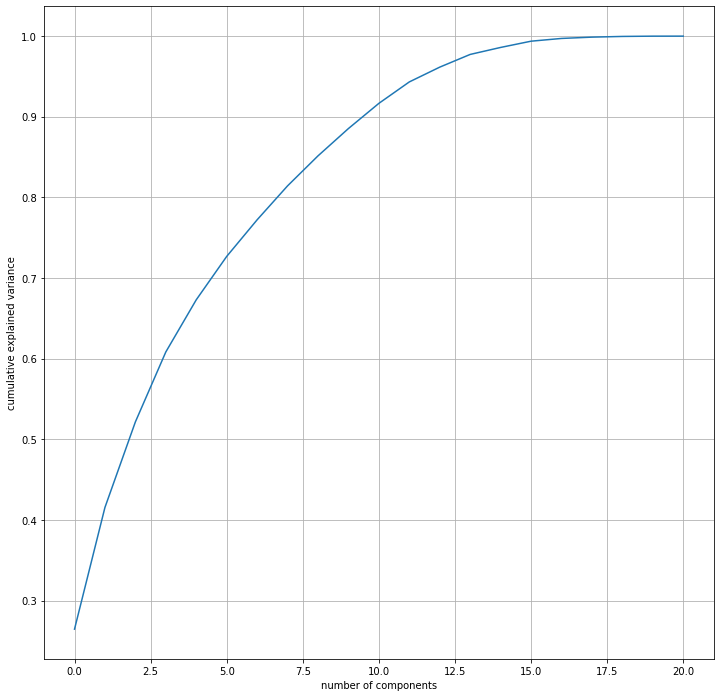

In [521]:
pca = PCA().fit(result_pca)

plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.gcf().set_size_inches(12,12)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.grid(True)

In [578]:
# По графику видим что 10 компонентов объясняют более 90% дисперсии в данных. То есть они являются основными при разделении на кластеры.
#Using incremental PCA for efficiency - saves a lot of time on larger datasets
from sklearn.decomposition import IncrementalPCA
pca_final = IncrementalPCA(n_components=10)

In [579]:
X = result_s.drop(['labels'], axis=1)

In [580]:
df_pca = pca_final.fit_transform(X)
df_pca.shape

(85, 10)

In [581]:
df_pca = pd.DataFrame(df_pca)

In [577]:
import plotly.express as px
from sklearn.decomposition import PCA

df = result_s.drop(['labels'], axis=1)
features = ['infm_mean', 'ppop_mean', 'grp_mean', 'cri_mean', 'avincratio_mean', 'belowpov_mean', 'uspend_mean', 'retail_mean', 'childpov_mean', 'overwpov_mean',
                    'workagepov_mean', 'dab_mean', 'alcolism_mean', 'drug_mean', 'alcmort_mean', 'wes_mean', 'construction_mean', 'constrratio_mean', 'gethome_mean', 'hloandebt_mean',
                  'childcrime_mean']

pca = PCA()
components = pca.fit_transform(df[features])
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    components,
    labels=labels,
    dimensions=range(10),
    color=df.index
)
fig.update_traces(diagonal_visible=False)
fig.show()

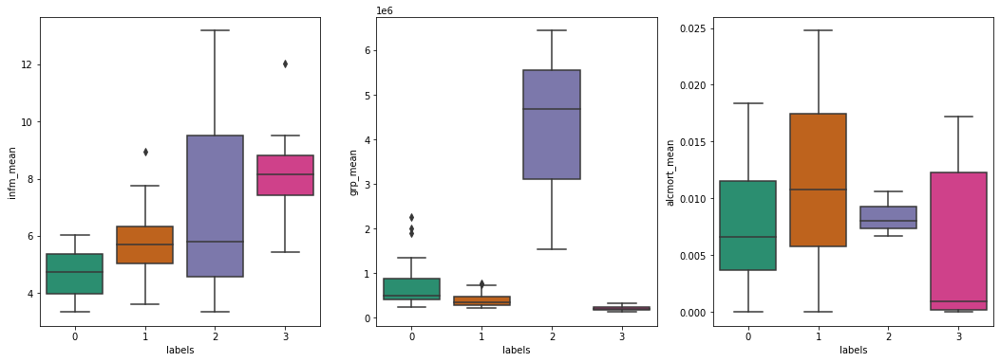

In [559]:
# кластер 3 - лидер по уровню детской смертности и аутсайдер по уровню ввп на душу населения. При это смертность от отравление алкоголем даже ниже чем в других кластерах.
import matplotlib.pyplot as plt 

plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
sns.boxplot(x='labels', y='infm_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 2)
sns.boxplot(x='labels', y='ppop_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 3)
sns.boxplot(x='labels', y='grp_mean', data=result, palette="Dark2")

plt.show()

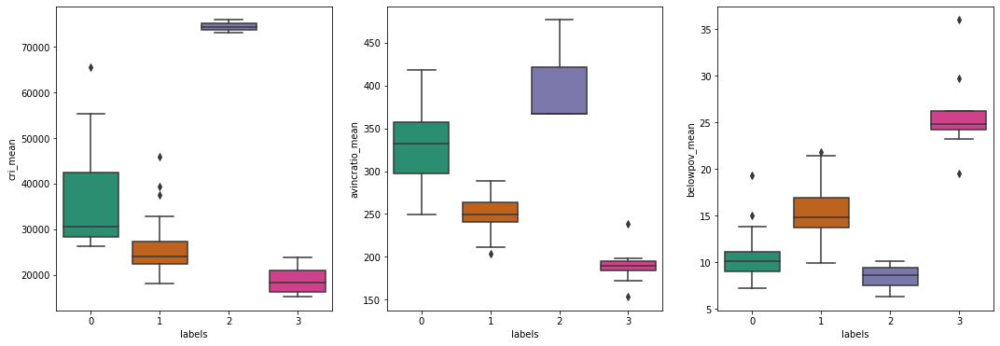

In [560]:
# определённо в основных нефтедобывающих регионах РФ (кластер 3) уровень дохода населения опережает другие. По степени финансовой обеспеченности за ним следуют регионы из кластера 0.
# такое распределение и подтверждает уровень населения за чертой бедности
plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
sns.boxplot(x='labels', y='cri_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 2)
sns.boxplot(x='labels', y='avincratio_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 3)
sns.boxplot(x='labels', y='belowpov_mean', data=result, palette="Dark2")

plt.show()

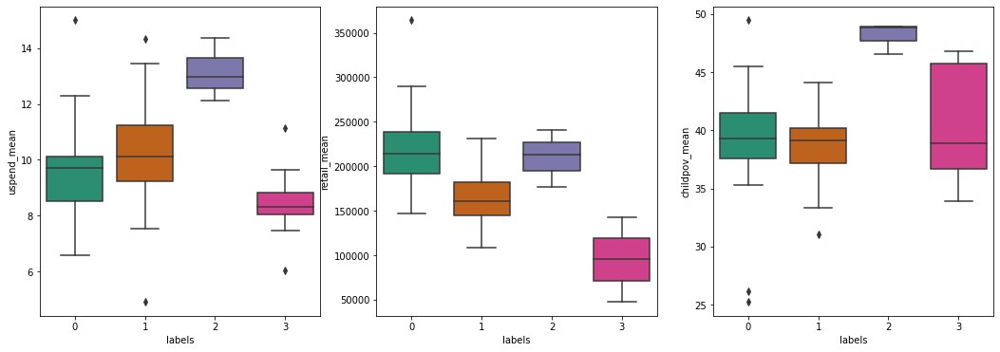

In [561]:
# низкий уровень объёма розничного оборота торговли опять указывает на проблемы бедности для регионов относящихся к кластеру 3
plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
sns.boxplot(x='labels', y='uspend_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 2)
sns.boxplot(x='labels', y='retail_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 3)
sns.boxplot(x='labels', y='childpov_mean', data=result, palette="Dark2")

plt.show()

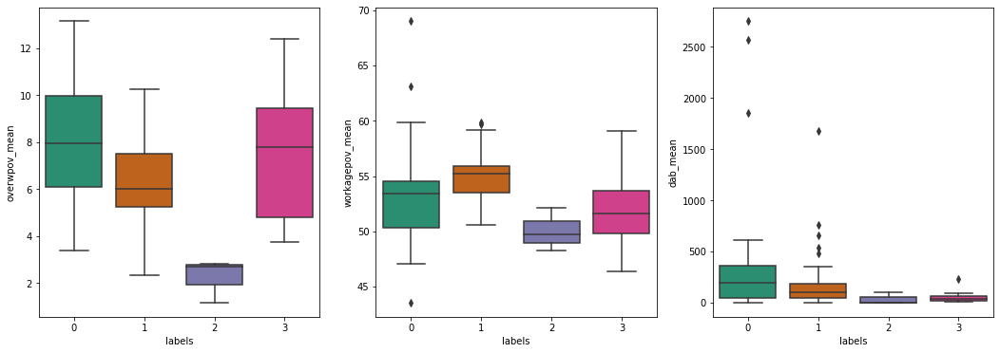

In [562]:
# в кластерах 0 и 3 пожилые люди нуждаются в поддержке, так как чаще оказываются за чертой бедности
plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
sns.boxplot(x='labels', y='overwpov_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 2)
sns.boxplot(x='labels', y='workagepov_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 3)
sns.boxplot(x='labels', y='dab_mean', data=result, palette="Dark2")

plt.show()

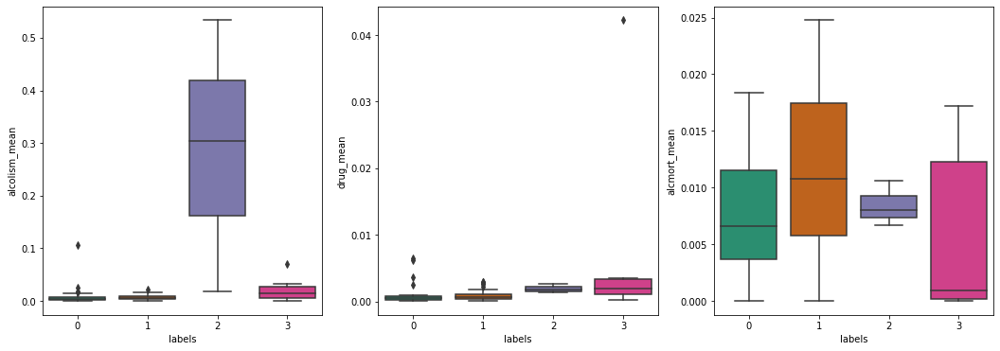

In [563]:
# население регионов кластера 3 большего всего страдаю проблемами в области алкоголизма и наркомания (кластер 2 проблему алкоголя надо рассмотреть внимательно, возможно ошибка в превоначальных данных)
plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
sns.boxplot(x='labels', y='alcolism_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 2)
sns.boxplot(x='labels', y='drug_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 3)
sns.boxplot(x='labels', y='alcmort_mean', data=result, palette="Dark2")

plt.show()

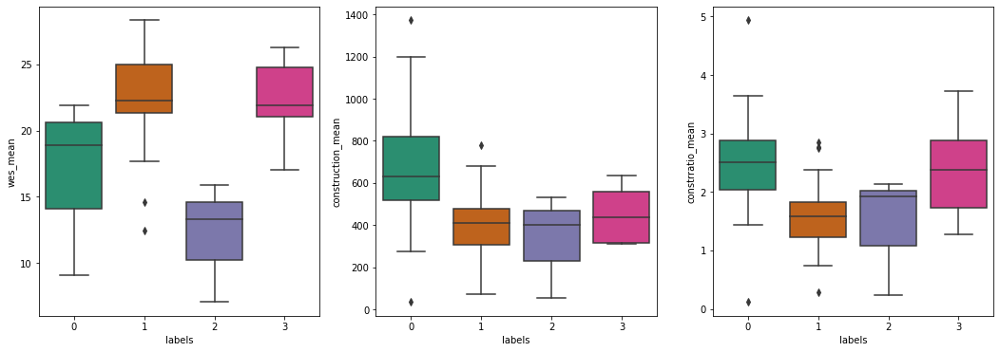

In [564]:
# значимая часть социальных расходов идёт субьектам из кластера 1
# темпы строительства нового жилья в депрессивных регионах весьма неплохи
plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
sns.boxplot(x='labels', y='wes_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 2)
sns.boxplot(x='labels', y='construction_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 3)
sns.boxplot(x='labels', y='constrratio_mean', data=result, palette="Dark2")

plt.show()

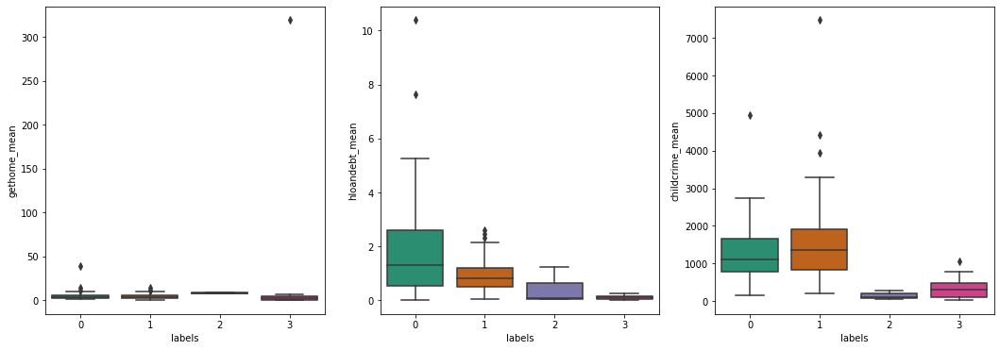

In [565]:
# интересно, что уровень детской преступности в депрессивных регионах оказался одним из самых низких
# жители регионов из кластера 0 больше всего склонны к невыполнению финансовых обязательств по ипотеке
plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
sns.boxplot(x='labels', y='gethome_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 2)
sns.boxplot(x='labels', y='hloandebt_mean', data=result, palette="Dark2")
plt.subplot(1, 3, 3)
sns.boxplot(x='labels', y='childcrime_mean', data=result, palette="Dark2")

plt.show()

In [507]:
import folium

In [508]:
m = folium.Map(location=[63.391522, 96.328125], zoom_start=3)

In [509]:
# загружаем данные по индексам регионов
import json

with open('/content/drive/My Drive/Heart Core Team/admin_level_4.geojson', encoding='utf-8') as json_file:
    map_data = json.load(json_file)

region_id = []
reg_list = map_data['features'][1:]
for el in reg_list:
    region_id.append((el['name'], el['id'])) 

region_id_df = pd.DataFrame(region_id)

region_id_df.columns = ['region', 'region_id']
region_id_df.head()

,region,region_id
0,Камчатский край,151233
1,Мурманская область,2099216
2,Пермский край,115135
3,Свердловская область,79379
4,Вологодская область,115106


In [510]:
region_id_df.region = region_id_df.region.apply(fix_regions_id)
region_id_df = region_id_df.dropna(subset = ['region'])
region_id_df.region = region_id_df.region.str.strip()
region_id_df.set_index('region', inplace=True)
region_id_df.head()

,region_id
region,
Камчатский край,151233
Мурманская область,2099216
Пермский край,115135
Свердловская область,79379
Вологодская область,115106


In [511]:
k_res_df = pd.DataFrame()
k_res_df = result_s['labels']

In [512]:
result_map = region_id_df.join(k_res_df, how='inner')

In [513]:
rel_ = folium.Choropleth(
       geo_data = '/content/drive/My Drive/Heart Core Team/admin_level_4.geojson', 
       name = 'Кластеризация по регионам',
       data = result_map,
       columns=['region_id', 'labels'], 
       key_on='id',
       bins = 4,
       fill_color="YlGn",
       nan_fill_color='darkblue',
       nan_fill_opacity=0.5,
       fill_opacity=0.7,
       line_opacity=0.2,
       legend_name= 'Кластеризация по регионам',
       highlight = True,
       show = False
)

In [514]:
rel_.add_to(m)

In [515]:
m

В результате проведённой кластеризации были определены 4 группы субъектов РФ по уровню бедности. Регионы относящиеся к 3му кластеру лидируют по уровню детской смертности и являются аутсайдерами по уровню ВВП на душу населения. При этом смертность от отравлением алкоголем даже ниже чем в других группах субъектов 

Определённо в основных нефтедобывающих регионах РФ (кластер 2) уровень дохода населения опережает другие. По степени финансовой обеспеченности за ним следуют регионы из кластера 0, где собраны в целом довольно прогрессивные в экономическом развитии регионы. Низкий уровень объёма розничного оборота торговли опять указывает на проблемы бедности для регионов относящихся к кластеру 3.

Но стоит отметить, что наряду с субъектами кластера 3, пожилые люди из продвинутых в экономическом плане регионов нуждаются в поддержке, так как чаще оказываются за чертой бедности.

Население регионов кластера 3 большего всего страдают проблемами в области алкоголизма и наркомании. Возможно - это следствие экономической отсталости от общего уровня развития экономики РФ.

Значимая часть социальных расходов продолжает идти субьектам из кластера 1 и 3. Это лишний раз хорошо объясняет уязвимость бедного населения регионов, относящихся к данным группам.

Темпы строительства нового жилья в депрессивных регионах оказались весьма неплохи. 

Интересно, что уровень детской преступности в депрессивных регионах находится в сравнительно более низких диапазонах чем в других регионах.

Казалось бы обеспеченные жители регионов из кластера 0 больше всего склонны к невыполнению финансовых обязательств по ипотеке. На это стоит также обратить внимание.

Мы хотели постараться подобрать как можно больше показателей не связанных напрямую с экономическим благополучием населения регионов. Было интересно посмотреть на такие косвенные признаки, как проблемы алкоголизма и наркомании, коммунальные и строительные аспекты жизни, а также дать оценку уровню преступности среди несовершеннолетних.

Однако стоит отметить, что именно финансово-экономические показатели оказываются наиболее устойчивыми в качестве определения территорий с бедными слоями населения.

При этом стоит учесть, что значительная часть социальных расходов приходится на благополучные регионы, где сосредоточены основные производства и добывающие предприятия. С учётом ухудшающейся экономической обстановки мы бы как раз рекомендовали бы обратить внимание на такие средние, казалось бы, достаточные регионы, из кластера 0 для выявления рисков связанных с обеднением населения.
